In [1]:
import joblib
import pandas as pd
import colorama as col
from matplotlib import pyplot as plt
import ffn
import numpy as np
import datetime as dt
import fxcmpy
from tqdm import tqdm
import sys
from sklearn.metrics import accuracy_score, make_scorer, precision_score, recall_score, precision_recall_curve, confusion_matrix, classification_report, f1_score, roc_auc_score
sys.path.append('../') 
import pyttsx3
engine = pyttsx3.init()
from slack_sdk import WebClient
_slack_token = joblib.load('TOKENS/_slack_token.dag')
client = WebClient(token=_slack_token)
import time
import warnings
import talib
#from pycaret.regression import *
from sklearn.linear_model import LinearRegression

In [2]:
TIK = ['AUD','NZD','GBP','JPY','CHF','CAD','SEK','NOK','ILS','MXN','USD','EUR']
RATE = [0.776,0.721,1.3912,1/105.91,1/0.892,1/1.2681,1/8.2884,1/8.4261,1/3.2385,1/20.1564,1,1/1.21]
df_ratefx = pd.DataFrame(index=TIK)
df_ratefx['rate'] = RATE

def shuttle():
    return(x,_ticker)

x = 'EUR/USD'
_period = 'm5'
_period2 = 'H1'
_ticker = x.replace('/','')
_start = '2010-01-01' # start the train there '2010-01-01'
_mid = '2016-08-30' # stop the train and begin the test there '2016-08-31'
_stop = '2018-12-31' # stop the test there. After that, it is kept for oos
_last = '2021-04-19' # '2020-12-31'
_nb_bougie_exit = 5555555555
_trigger_reengage = 0
_trigger_target = 1
_trigger_invers = 0
_trigger_sl = 1
_verbose = 0
_cash_ini = 200000
_target = 0.002
_exposure = 2
_sl = 0.001
_rate = df_ratefx.loc[x[4:],'rate']
_size = _cash_ini / df_ratefx.loc[x[:3],'rate']
_trigger_spread = 0.025

_token = joblib.load('TOKENS/_api_token.dag')
_server = 'demo'

try:
    con
except NameError:
    con = fxcmpy.fxcmpy(access_token=_token, log_level='error',server=_server)
    print(col.Fore.GREEN+'Connexion établie'+col.Style.RESET_ALL)
    print('Compte utilisé : ',con.get_account_ids())
    engine.say("Gaulem is Connected")
    engine.runAndWait()
            
else:
    con = conX(con,_token,_server)


Connexion établie
Compte utilisé :  [1285488]


In [3]:
try:   
    _last_bougie = (con.get_candles(x,period='m5',number=1).index.hour[0])
    _now = dt.datetime.now().hour
    
    if _now - _last_bougie < 0:
        _decay = _now + 24 - _last_bougie
    
    else:
        _decay = _now - _last_bougie


    print('\nDecay = ',_decay,'\n')
    joblib.dump(_decay,'VARS/'+_ticker+'/'+'decay.dag')
    _no_access = 0
except:
    print('\n',col.Back.RED,col.Fore.BLACK,'/!\ LES DONNEES NE SONT PAS ACCESSIBLES. PAS DE MAJ NI DE LIVE /!\ ',col.Style.RESET_ALL)
    _no_access = 1


Decay =  2 



In [6]:
df = joblib.load('BASES/'+_ticker+'_'+_period)
print('\nShape de df loaded :',df.shape,'\n')          
df = strategy(df)
_verbose = 0
_bt_report = 1
_year_bottom = _stop
_year_top = _last
print(col.Fore.RED,'###############################################################################################')
print(' ####################################### OOS WITHOUT AI ########################################')
print(' ###############################################################################################',col.Style.RESET_ALL)
##### Backtest Over Night
TRACKER,_nb_looser = bt(df,_year_bottom,_year_top,_nb_bougie_exit,_trigger_reengage,_trigger_target,_trigger_invers,_trigger_sl,_verbose,_cash_ini,\
        _rate,x,_target,_exposure,_size,_sl,_bt_report=_bt_report)

print(col.Fore.CYAN+'\n\nTRAITEMENT STATISTIQUE DES DONNEES\n',col.Style.RESET_ALL)
candle_feedback = joblib.load('BT/'+_ticker+'_candle_feedback_oos.dag')
candle_feedback = timerange1D(candle_feedback)
stats = candle_feedback.drop(['Symbol','Size','Date'],axis=1).calc_stats()
stats[_ticker].display()
print(col.Fore.CYAN+'\n\nMONTHLY RETURN FOR '+x+'\n',col.Style.RESET_ALL)
stats[_ticker].display_monthly_returns()
_bt_report = 0

_year_bottom = _start
_year_top = _stop
print()
print(col.Fore.CYAN,'###############################################################################################')
print(' #################################### TRAIN/TEST WITHOUT AI ####################################')
print(' ###############################################################################################',col.Style.RESET_ALL)


TRACKER,_nb_looser = bt(df,_year_bottom,_year_top,_nb_bougie_exit,_trigger_reengage,_trigger_target,_trigger_invers,_trigger_sl,_verbose,_cash_ini,\
        _rate,x,_target,_exposure,_size,_sl)

print()
print(col.Fore.BLUE,'###############################################################################################')
print(' #################################### DENOISING & ENHANCING ####################################')
print(' ###############################################################################################',col.Style.RESET_ALL)
while _nb_looser > 0 :
    
    df['TRACKER'] = np.where(df.index.isin(TRACKER),1,0)
    df['Valid'] = np.where(((df.Signal!=0)&(df.TRACKER==1)),1,0)
    df['Signal'] = np.where(((df.Valid==1)&(df.Signal==1)),1,np.where(((df.Valid==1)&(df.Signal==-1)),-1,0))
    ##### Purification of signal by denoising and enhancing
    TRACKER,_nb_looser = bt(df,_year_bottom,_year_top,_nb_bougie_exit,_trigger_reengage,_trigger_target,_trigger_invers,_trigger_sl,_verbose,_cash_ini,\
            _rate,x,_target,_exposure,_size,_sl)

print("OK")


Shape de df loaded : (820140, 62) 

 ###############################################################################################
 ####################################### OOS WITHOUT AI ########################################
 ############################################################################################### 
Librairies imported

_bt_report :  1
Verbose :  0
Save :  0


Début des opérations horodatée à 2021-04-27 09:47:10.820655

Chargement de la nouvelle base


 Le rate du ticker EUR/USD est à  1.0 
Bases chargées
TETEL process effectué
 ENTERING THE BACKTEST 
100%|██████████| 166297/166297 [00:12<00:00, 12901.75it/s]
 For ticker  EUR/USD 
 
Total Profit & Loss : $  -183223.04 . En  2630   transactions.
 
Winners Number : 751 
 
Loosers number : 1879 
BT's execution time 0:00:19.807879
 EUR/USD  results 
 Tested Period 2018-12-31  à 2021-04-19 
 Total Number of trades 2630 
Started Cash : 200000
P&L in currency:  -183223.04$ 
P&L in %:  -91.61% 
Average trade duratio

In [7]:
def featuring(df):
    features = pd.DataFrame()
    features = pd.DataFrame(index=df.index)
    features['Symbol'] = df['Symbol']
    features['Date'] = df['Date']
    features['FEMA_21'] = df['Close'] * df['EMA_21'] # 0.76 en *, 0.48 en + et 0.35 en -
    features['FEMA_8'] = df['Close'] * df['EMA_8']# 1.31 en *
    features['FADRLo'] = df['Close'] * df['ADR_Low'] # 1.38 
    features['FADRHi'] = df['Close'] * df['ADR_High'] # 1.59 
    features['FRVI40'] = df['Close'] * df['RVI'] # 0.21 en *, 0.07 seul et 0 avec *df['Close']/100
    features['FRVI60'] = df['Close'] * df['RVI'] # 0.21 en *, 0.07 seul et 0 avec *df['Close']/100
    features['FONLOSMA5'] = df['Close'] * df['ONLOSMA_5'] # 0.9 en *, 0.14 seul et 0 avec df['Low'] - 
    features['FONHISMA5'] = df['Close'] * df['ONHISMA_5'] # 0.97 en *, 0.41 seul et  0.07 avec df['High'] - 
    features['FONLOSMA21'] = df['Close'] * df['ONLOSMA_21'] # 0.35 en *, 0.28 seul et 0 avec df['Low'] - 
    features['FONHISMA21'] = df['Close'] * df['ONHISMA_21'] # 1.04 en *, 0.55 seul et 0.28 avec df['High'] - 
    features['FONLOSMA34'] = df['Close'] * df['ONLOSMA_34'] # 0.55 en *, 0.35 seul et 0 avec df['Low'] - 
    features['FONHISMA34'] = df['High'] * df['ONHISMA_34'] # 0.83 en *, 0.48 en + 0.14 avec et 0 sans
    features['FSBGAMMA'] = df['SB_Gamma'] + df['Close'] # 0.14 avec + et 0 sans * df['Close']
    features['FOPENWEEKLY'] = df['Close'] * df['OpenShift_weekly'] # 0.55 en * et 0.28 en +
    features['FHIGHWEEKLY'] = df['Close'] * df['HighShift_weekly'] # 0.48 en * et 0 en -
    features['FLOWWEEKLY'] = df['Close'] * df['LowShift_weekly'] # 0.35 en * et 0.07 en -
    features['FCLOSEWEEKLY'] = df['Close'] * df['CloseShift_weekly'] # 0.48 en * et 0 en -
    features['FOPENDAILY'] = df['Close'] * df['OpenShift_daily'] # 0.14 en * et 0.14 en -
    features['FHIGHDAILY'] = df['Close'] * df['HighShift_daily'] # 1.24 en * et 0 en -
    features['FLOWDAILY'] = df['Close'] * df['LowShift_daily'] # 0.69 en * et 0 en -
    features['FCLOSEDAILY'] = df['Close'] * df['CloseShift_daily'] # 1.24 en * et 0 en -
    '''#features['FOPENHOURLY'] = df['Close'] - df['OpenShift_hourly']#.shift(1)
    #features['FHIGHHOURLY'] = df['Close'] - df['HighShift_hourly']#.shift(1)
    #features['FLOWHOURLY'] = df['Close'] - df['LowShift_hourly']#.shift(1)
    #features['FCLOSEHOURLY'] = df['Close'] - df['CloseShift_hourly']#.shift(1)'''
    features['FSMA200'] = (df['Close'] * df['SMA_200']) # 0.41 en * et 0 en -
    features['FBOLUP20'] = (df['Close'] * df['UpperBand']) # 0.55 en * et 0.21 en -
    features['FBOLLOW20'] = (df['Close'] * df['LowerBand']) # 0.14 en * et 0.21 en -
    features['FRSI2H'] = df['Close'] - df['RSI_2_hourly'] # 0.0 en * et 0.14 en -
    features['FRSI14H'] = df['Close'] - df['RSI_14_hourly'] # 0.07 en * et 0.41 en -
    features['FPP'] = df['Close'] * df['PP'] # 0.35 en * et 0 en -
    features['FS38'] = df['Close'] * df['S38'] # 0.28 en * et 0 en -
    features['FS62'] = df['Close'] * df['S62'] # 0.48 en * et 0 en -
    features['FS78'] = df['Close'] * df['S78'] # 0.28 en * et 0 en -
    features['FS100'] = df['Close'] * df['S100'] # 0.14 en * et 0.07 en -
    features['FS138'] = df['Close'] + df['S138'] # 0.35 en + et 0 en -
    features['FS162'] = df['Close'] * df['S162'] # 0.07 en * et 0 en -
    features['FS178'] = df['Close'] * df['S178'] # 0.07 en * et 0 en -
    features['FS200'] = df['Close'] * df['S200'] # 0.41 en * ou + et 0 en -
    features['FR38'] = df['Close'] * df['R38'] # 1.38 en *, 1.31 en + et 0 en -
    features['FR62'] = df['Close'] * df['R62'] # 0.41 en * et 0 en -
    features['FR78'] = df['Close'] * df['R78'] # 1.17 en +, 0.41 en * et 0 en -
    features['FR100'] = df['Close'] + df['R100'] # 1.66 en +, 1.31 en * et 0.28 en -
    features['FR138'] = df['Close'] + df['R138'] # 2.14 en +, 2.07 en * et 0.14 en -
    features['FR162'] = df['Close'] + df['R162'] # 2.9 en +, 2.28 en * et 0.35 en -
    features['FR178'] = df['Close'] + df['R178']# 2.7 en +, 2.14 en * et 0.28 en -
    features['FR200'] = df['Close'] + df['R200']# 2.97 en +, 2.83 en * et 0.07 en -
    features['SBATR'] = (df['Close'] - df['Open']) / df['ATR_14'] # 0.21
    features['FRSI2'] = df['Close'] + df['RSI_2_hourly'] # 0.41 en +, 0.14 avec *df['Close']/100
    features['FRSI14'] = df['Close'] + df['RSI_14_hourly'] # 0.28 avec + 0.07 avec *df['Close']/100
    features['Signal'] = df['Signal']
    
    #features = features.dropna()
    return(features.sort_index(axis=0))

In [8]:
%%time
df = strategy(df)

features = featuring(df)
print('Shape de features',features.shape)
features['TRACKER'] = np.where(features.index.isin(TRACKER),1,0)

# First, we must have an output. We'll call it 'Valid'. It wil be where Tracker & Signal are both to 1
features['Valid'] = np.where(((features.Signal!=0)&(features.TRACKER==1)),1,0) # Don't miss the point that even a Signal -1 must be considered as a good one by TRACKER

# On établit les constantes et on les sauvegarde
features_max = DagMaxBase(features)
joblib.dump(features_max,'VARS/'+_ticker+'/'+_ticker+'_MAX.dag')

# And drop the nan
features = features.dropna()
##### Signal is from strategy. This is potential good one. But we have to create the TRACKER column where the Signal where efficient

features_train, features_test, features_oos = split_learn(features)

print('Shape de features',features.shape,features_test.shape,features_oos.shape)

for label in features_train.drop(['Date','Symbol','Signal','TRACKER','Valid'],axis=1).columns:
    features_train[label] = features_train[label] / features_max[label][0]
for label in features_test.drop(['Date','Symbol','Signal','TRACKER','Valid'],axis=1).columns:
    features_test[label] = features_test[label] / features_max[label][0]
for label in features_oos.drop(['Date','Symbol','Signal','TRACKER','Valid'],axis=1).columns:
    features_oos[label] = features_oos[label] / features_max[label][0]




Shape de features (820140, 49)
Shape de features (714078, 51) (7771, 51) (166378, 51)
CPU times: user 1.86 s, sys: 890 ms, total: 2.75 s
Wall time: 2.21 s


In [247]:
def learning(features_train, features_test, _save=0):
    from sklearn.neural_network import MLPClassifier
    from xgboost import XGBClassifier
    import xgboost as xbg


    #_model = MLPClassifier(hidden_layer_sizes=(300,15), activation='relu', solver='adam', alpha=0.000001, batch_size='auto', learning_rate='constant', learning_rate_init=0.001, power_t=0.5, max_iter=400, shuffle=True, random_state=26, tol=0.0000001, verbose=False, warm_start=True, momentum=0.9, nesterovs_momentum=True, early_stopping=False, validation_fraction=0.1, beta_1=0.8, beta_2=0.999, epsilon=1e-08)

    #_model = MLPClassifier(hidden_layer_sizes=(500,230), activation='relu', solver='adam', alpha=0.000001, batch_size='auto', learning_rate='constant', learning_rate_init=0.0001, power_t=0.5, max_iter=400, shuffle=True, random_state=26, tol=0.0000001, verbose=False, warm_start=True, momentum=0.9, nesterovs_momentum=True, early_stopping=False, validation_fraction=0.1, beta_1=0.8, beta_2=0.999, epsilon=1e-08)

    #_model = MLPClassifier(hidden_layer_sizes=(400,130), activation='relu', solver='adam', alpha=1e-06, batch_size='auto', learning_rate='constant', learning_rate_init=1e-05, power_t=0.5, max_iter=4100, shuffle=True, random_state=42, tol=0.0000001, verbose=False, warm_start=True, momentum=0.9, nesterovs_momentum=True, early_stopping=False, validation_fraction=0.1, beta_1=0.8, beta_2=0.999, epsilon=1e-08)
    
    
    _param = {}
    _param['booster'] = 'dart'
    _param['verbosity'] = 3
    _param['objective'] = 'binary:logistic'
    _param['eval_metric'] = 'logloss'
    _param['validate_parameters'] = True
    _param['disable_default_eval_metric'] = True
    _param['eta'] = 0.3
    _param['gamma'] = 1
    _param['max_depth'] = 10
    _param['min_child_weight']=1
    _param['max_delta_step'] = 0
    _param['subsample']= 1
    _param['colsample_bytree']=1
    _param['silent'] = False
    _param['seed'] = 42
    _param['base_score'] = 0.5
    _param['missing'] = False
    _param['use_label_encoder'] = False
    
    _seed_max = 0
    _prec_max = 0
    '''for _seed in range(120):
        _model = XGBClassifier(seed=_seed,eval_metric='logloss')
        _model.fit(features_train.drop(['Date','Symbol','TRACKER','Valid','Signal'],axis=1),features_train.Valid)
        yhat = _model.predict(features_test.drop(['Date','Symbol','TRACKER','Valid','Signal'],axis=1))
        prec = round(precision_score(features_test.Valid, yhat,pos_label=1) * 100,2)
        if prec > _prec_max:
            _prec_max = prec
            _seed_max = _seed

    print('le meilleur seed est ',_seed_max,'et la meilleure prec ',_prec_max)'''

    _model = XGBClassifier(
        booster = 'dart',
        verbosity = 0,
        objective = 'binary:logistic',
        eval_metric = 'logloss',
        validate_parameters = True,
        disable_default_eval_metric = True,
        eta = 1,
        gamma = 0.01,
        max_depth = 5,
        min_child_weight = 1,
        max_delta_step = 4,
        subsample = 1,
        sampling_method = 'gradient_based',
        colsample_bytree = 1,
        reg_lambda = 1,
        tree_method = 'exact',
        scale_pos_weight = 1,
        updater = 'grow_colmaker,sync,refresh,prune',
        refresh_leaf = 0,
        process_type = 'default',
        grow_policy = 'lossguide',
        max_bin = 256,
        predictor = 'cpu_predictor',
        num_parallel_tree = 1,
        silent = False,
        seed = 26,
        base_score = 0.55,
        missing = 999,
        use_label_encoder = False,
        sample_type='weighted',
        normalize_type='forest',
        rate_drop = 0,
        skip_drop = 0
         )
    _model.fit(features_train.drop(['Date','Symbol','TRACKER','Valid','Signal'],axis=1),features_train.Valid)
    yhat = _model.predict(features_test.drop(['Date','Symbol','TRACKER','Valid','Signal'],axis=1),ntree_limit=100)
    accu = round(accuracy_score(features_test.Valid, yhat) * 100,2)
    prec = round(precision_score(features_test.Valid, yhat,pos_label=1) * 100,2)
    recall = round(recall_score(features_test.Valid, yhat) * 100,2)
    f1 = round(f1_score(features_test.Valid, yhat) * 100,2)


    print('Signaux - Accuracy :' ,accu,'%')
    print('Signaux - Precision :',prec,'%')
    print('Signaux - Recall :', recall,'%')
    print('Achat - F-measure: :' ,f1,'%')
    print('\n')
    print(classification_report(features_test.Valid, yhat, target_names=['Neg', 'Pos']))
    conf_matrix = pd.DataFrame(columns=['Bonnes_Estimations','Mauvaises_Estimations'])
    tt = confusion_matrix(features_test.Valid, yhat, labels=[1,0])    #_model.classes_)

    conf_matrix.loc['vrais-réels'] = tt[0]
    conf_matrix.loc['faux-réels'] = tt[1]

    print(conf_matrix)
    print()
    print(col.Fore.BLUE,'Signaux pour',col.Fore.YELLOW,x,col.Style.RESET_ALL)
    _tp = tt[0][0]
    _fn = tt[0][1]
    _prec = round((tt[0][0]/(tt[0][0]+tt[0][1]))*100,2)
    _rec = round((tt[0][1]/(tt[0][0]+tt[0][1]))*100,2)

    print('Vrais signaux trouvés    : ',tt[0][0])
    print('Vrais signaux non trouvé :',tt[0][1])
    print('Total des vrais signaux  :',tt[0][0]+tt[0][1])
    
    if _prec > 69 and prec > 69 :
        print(col.Fore.GREEN,col.Style.RESET_ALL)
    elif _prec < 51 or prec < 51 :
        print(col.Fore.RED,col.Style.RESET_ALL)
    else:
        print(col.Fore.YELLOW)
    print('Precision : ',_prec,'%')
    if _rec > 69 and _rec > 69 :
        print(col.Fore.GREEN,col.Style.RESET_ALL)
    elif _rec < 51 or _rec < 51 :
        print(col.Fore.RED,col.Style.RESET_ALL)
    else:
        print(col.Fore.YELLOW)
    print('Recall',_rec,'%',col.Style.RESET_ALL)
    print('')
    print('Roc_auc score')
    print('-------------------------------------------------------')
    print(roc_auc_score(features_test.Valid, yhat))
    print('')

    if _save == 1:
        joblib.dump(_model,'MODELS/Save_'+_ticker+'_'+_period+'.dag')

    
    return(_model)
_save=0
_model = learning(features_train, features_test)

Signaux - Accuracy : 82.29 %
Signaux - Precision : 13.65 %
Signaux - Recall : 9.37 %
Achat - F-measure: : 11.11 %


              precision    recall  f1-score   support

         Neg       0.88      0.92      0.90      6853
         Pos       0.14      0.09      0.11       918

    accuracy                           0.82      7771
   macro avg       0.51      0.51      0.51      7771
weighted avg       0.80      0.82      0.81      7771

            Bonnes_Estimations Mauvaises_Estimations
vrais-réels                 86                   832
faux-réels                 544                  6309

 Signaux pour  EUR/USD 
Vrais signaux trouvés    :  86
Vrais signaux non trouvé : 832
Total des vrais signaux  : 918
 
Precision :  9.37 %
 
Recall 90.63 % 

Roc_auc score
-------------------------------------------------------
0.5071503121734451

/Users/dag26/anaconda3/envs/DataSciences/lib/python3.8/site-packages/xgboost/core.py:101: UserWarning: ntree_limit is deprecated, use `iteration_rang

In [252]:
%%time
from sklearn.model_selection import GridSearchCV, KFold
from xgboost import XGBClassifier
# XGBoost
# n_jobs=-1 to allow run it on all cores
params = {
    'n_estimators': [100, 200, 500],
    'learning_rate': [0.01,0.05,0.1],
    'booster': ['gbtree', 'gblinear'],
    'gamma': [0, 0.5, 1],
    'reg_alpha': [0, 0.5, 1],
    'reg_lambda': [0.5, 1, 5],
    'base_score': [0.2, 0.5, 1]
}

gs2 = GridSearchCV(XGBClassifier(n_jobs=-1), params, n_jobs=-1, cv=KFold(n_splits=3), scoring='roc_auc')
gs2.fit(features_train.drop(['Date','Symbol','TRACKER','Valid','Signal'],axis=1),features_train.Valid)

print('Best score:', gs2.best_score_)
print('Best score:', gs2.best_params_)

/Users/dag26/anaconda3/envs/DataSciences/lib/python3.8/site-packages/xgboost/sklearn.py:1146: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)
Best score: 0.5422830585821812
Best score: {'base_score': 0.5, 'booster': 'gbtree', 'gamma': 0, 'learning_rate': 0.05, 'n_estimators': 100, 'reg_alpha': 1, 'reg_lambda': 1}
CPU times: user 53.1 s, sys: 5.12 s, total: 58.2 s
Wall time: 1h 31min 16s


In [253]:
%%time
from sklearn.model_selection import GridSearchCV, KFold
from xgboost import XGBClassifier
# XGBoost
# n_jobs=-1 to allow run it on all cores
params = {
    'n_estimators': [50, 80, 1000],
    'learning_rate': [0.001,0.05,0.5],
    'booster': ['gbtree', 'gblinear'],
    'gamma': [0.5, 0.8, 3],
    'reg_alpha': [0, 0.5, 1],
    'reg_lambda': [0.5, 1, 5],
    'base_score': [0.2, 0.5, 1]
}

gs2 = GridSearchCV(XGBClassifier(n_jobs=-1), params, n_jobs=-1, cv=KFold(n_splits=3), scoring='roc_auc')
gs2.fit(features_train.drop(['Date','Symbol','TRACKER','Valid','Signal'],axis=1),features_train.Valid)

print('Best score:', gs2.best_score_)
print('Best score:', gs2.best_params_)

/Users/dag26/anaconda3/envs/DataSciences/lib/python3.8/site-packages/joblib/externals/loky/process_executor.py:688: UserWarning: A worker stopped while some jobs were given to the executor. This can be caused by a too short worker timeout or by a memory leak.
  warnings.warn(
/Users/dag26/anaconda3/envs/DataSciences/lib/python3.8/site-packages/xgboost/sklearn.py:1146: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)
Best score: 0.5419238928937629
Best score: {'base_score': 0.5, 'booster': 'gbtree', 'gamma': 3, 'learning_rate': 0.05, 'n_estimators': 50, 'reg_alpha': 0.5, 'reg_lambda': 1}
CPU times: user 1min, sys: 10.3 s, total: 1min 10s
Wall time: 2h 8min

In [9]:
# import required libraries for data analysis
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

%matplotlib inline
import warnings
warnings.filterwarnings('ignore')

X_train = features_train.drop(['Date','Symbol','TRACKER','Valid','Signal'],axis=1)
X_test = features_test.drop(['Date','Symbol','TRACKER','Valid','Signal'],axis=1)
y_train = features_train.Valid
y_test = features_test.Valid
df = features.drop(['Date','Symbol','TRACKER','Valid','Signal'],axis=1)

In [10]:
# full correlation table
df.corr().style.background_gradient(cmap='viridis')

,FEMA_21,FEMA_8,FADRLo,FADRHi,FRVI40,FRVI60,FONLOSMA5,FONHISMA5,FONLOSMA21,FONHISMA21,FONLOSMA34,FONHISMA34,FSBGAMMA,FOPENWEEKLY,FHIGHWEEKLY,FLOWWEEKLY,FCLOSEWEEKLY,FOPENDAILY,FHIGHDAILY,FLOWDAILY,FCLOSEDAILY,FSMA200,FBOLUP20,FBOLLOW20,FRSI2H,FRSI14H,FPP,FS38,FS62,FS78,FS100,FS138,FS162,FS178,FS200,FR38,FR62,FR78,FR100,FR138,FR162,FR178,FR200,SBATR,FRSI2,FRSI14
FEMA_21,1.000000,0.999998,0.999595,0.999616,0.320136,0.320136,0.999996,0.999996,0.999999,0.999999,0.999997,0.999995,-0.000853,0.997371,0.997229,0.997118,0.996676,0.999797,0.999749,0.999752,0.999753,0.999916,0.999989,0.999989,-0.000830,-0.016013,0.998437,0.997966,0.997395,0.996876,0.996003,0.993595,0.992484,0.991296,0.989503,0.998367,0.998063,0.997744,0.996757,0.995452,0.994414,0.993601,0.992369,-0.000477,0.007556,0.032104
FEMA_8,0.999998,1.000000,0.999579,0.999601,0.320122,0.320122,0.999999,0.999999,0.999995,0.999995,0.999989,0.999987,-0.000846,0.997355,0.997212,0.997101,0.996659,0.999781,0.999734,0.999736,0.999738,0.999902,0.999986,0.999986,-0.002014,-0.016760,0.998421,0.997950,0.997379,0.996860,0.995987,0.993579,0.992468,0.991280,0.989486,0.998351,0.998048,0.997729,0.996741,0.995437,0.994399,0.993586,0.992355,-0.000300,0.008739,0.032851
FADRLo,0.999595,0.999579,1.000000,0.999692,0.319889,0.319889,0.999577,0.999574,0.999594,0.999591,0.999608,0.999602,-0.000944,0.997634,0.997397,0.997508,0.996964,0.999790,0.999700,0.999790,0.999755,0.999763,0.999574,0.999588,0.006221,0.004601,0.998742,0.998359,0.997842,0.997361,0.996540,0.994273,0.993168,0.992018,0.990277,0.998585,0.998228,0.997872,0.996911,0.995524,0.994436,0.993588,0.992310,-0.000562,0.000503,0.011493
FADRHi,0.999616,0.999601,0.999692,1.000000,0.319887,0.319887,0.999595,0.999600,0.999611,0.999616,0.999625,0.999631,-0.000870,0.997727,0.997714,0.997406,0.997080,0.999787,0.999816,0.999718,0.999780,0.999779,0.999613,0.999591,0.005973,0.004175,0.998816,0.998247,0.997615,0.997053,0.996122,0.993529,0.992438,0.991206,0.989353,0.998843,0.998598,0.998319,0.997326,0.996120,0.995141,0.994369,0.993193,-0.000530,0.000750,0.011917
FRVI40,0.320136,0.320122,0.319889,0.319887,1.000000,1.000000,0.319936,0.320304,0.320093,0.320185,0.320154,0.320312,0.000195,0.319241,0.318993,0.319297,0.319043,0.319982,0.319887,0.320035,0.319985,0.320065,0.321154,0.319112,0.002369,-0.008106,0.319453,0.319390,0.319262,0.319134,0.318906,0.318662,0.317927,0.317586,0.317064,0.319345,0.319195,0.319057,0.319048,0.318533,0.318140,0.317839,0.317390,-0.001070,-0.000213,0.013262
FRVI60,0.320136,0.320122,0.319889,0.319887,1.000000,1.000000,0.319936,0.320304,0.320093,0.320185,0.320154,0.320312,0.000195,0.319241,0.318993,0.319297,0.319043,0.319982,0.319887,0.320035,0.319985,0.320065,0.321154,0.319112,0.002369,-0.008106,0.319453,0.319390,0.319262,0.319134,0.318906,0.318662,0.317927,0.317586,0.317064,0.319345,0.319195,0.319057,0.319048,0.318533,0.318140,0.317839,0.317390,-0.001070,-0.000213,0.013262
FONLOSMA5,0.999996,0.999999,0.999577,0.999595,0.319936,0.319936,1.000000,0.999999,0.999993,0.999992,0.999986,0.999983,-0.000839,0.997347,0.997200,0.997098,0.996651,0.999777,0.999726,0.999734,0.999733,0.999898,0.999981,0.999986,-0.002261,-0.016901,0.998415,0.997949,0.997381,0.996864,0.995994,0.993594,0.992483,0.991297,0.989507,0.998340,0.998033,0.997712,0.996725,0.995415,0.994374,0.993559,0.992325,-0.000476,0.008987,0.032992
FONHISMA5,0.999996,0.999999,0.999574,0.999600,0.320304,0.320304,0.999999,1.000000,0.999992,0.999993,0.999985,0.999985,-0.000845,0.997355,0.997217,0.997095,0.996659,0.999777,0.999733,0.999729,0.999734,0.999898,0.999986,0.999981,-0.002234,-0.016882,0.998419,0.997943,0.997368,0.996847,0.995971,0.993555,0.992443,0.991253,0.989456,0.998355,0.998055,0.997737,0.996750,0.995451,0.994416,0.993605,0.992376,-0.000478,0.008960,0.032973
FONLOSMA21,0.999999,0.999995,0.999594,0.999611,0.320093,0.320093,0.999993,0.999992,1.000000,0.999999,0.999997,0.999994,-0.000851,0.997365,0.997218,0.997116,0.996670,0.999794,0.999744,0.999752,0.999750,0.999914,0.999987,0.999992,-0.0007

In [17]:
df.shape,i

((714078, 46), 10)

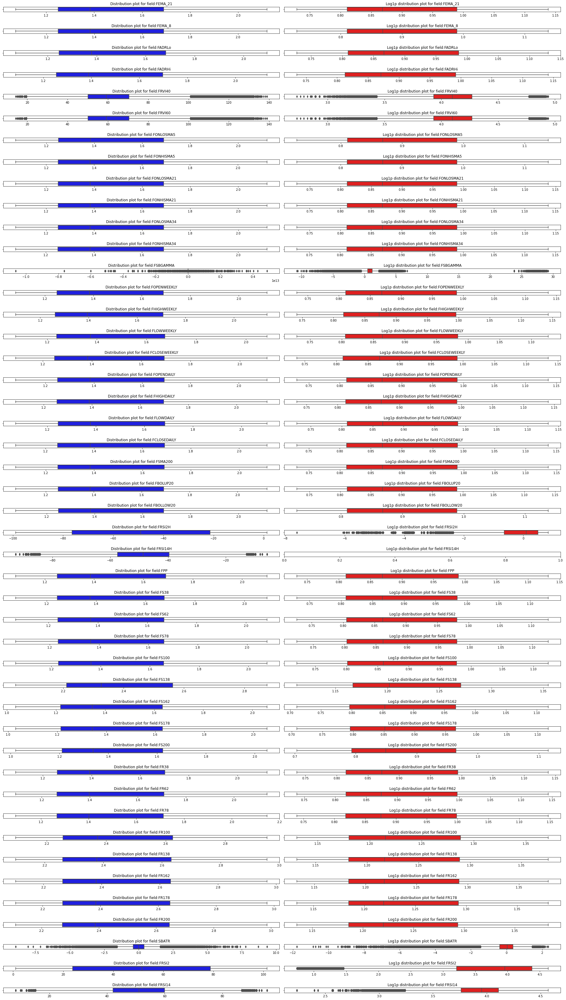

In [19]:
# outlier check
plt.figure(figsize=(26, 46))

for i, c in enumerate(df.select_dtypes(include='number').columns):
    plt.subplot(46,2,i*2+1)
    sns.boxplot(df[c], color='blue')
    plt.title('Distribution plot for field:' + c)
    plt.xlabel('')
    plt.tight_layout(pad=0.4, w_pad=0.5, h_pad=1.0)

    
    plt.subplot(46,2,i*2+2)
    sns.boxplot(df[c].apply('log1p'), color='red')
    plt.title('Log1p distribution plot for field:' + c)
    plt.xlabel('')
    plt.tight_layout(pad=0.4, w_pad=0.5, h_pad=1.0)

In [20]:
plt.figure(figsize=(15, 12))

for i, c in enumerate(df.select_dtypes(include='number').columns):
    plt.subplot(5,2,i+1)
    sns.distplot(df[c])
    plt.title('Distribution plot for field:' + c)
    plt.xlabel('')
    plt.tight_layout(pad=0.4, w_pad=0.5, h_pad=1.0)

ValueError: num must be 1 <= num <= 10, not 11

In [257]:
from sklearn.ensemble import ExtraTreesClassifier
from sklearn.model_selection import cross_validate
from sklearn.ensemble import VotingClassifier

model = votesClass
model.fit(X_train, y_train)
y_train_hat = model.predict(X_train)
y_test_hat = model.predict(X_test)

print(model)
print('Train performance')
print('-------------------------------------------------------')
print(classification_report(y_train, y_train_hat))

print('Test performance')
print('-------------------------------------------------------')
print(classification_report(y_test, y_test_hat))

print('Roc_auc score')
print('-------------------------------------------------------')
print(roc_auc_score(y_test, y_test_hat))
print('')

print('Confusion matrix')
print('-------------------------------------------------------')
print(confusion_matrix(y_test, y_test_hat))

NameError: name 'votesClass' is not defined

In [216]:
%%time
df_oos = df[(df.Date > _stop)&(df.Date <= _last)].dropna()

df_oos = df_oos[df_oos.Symbol==x.replace('/','')]


df_oos['Valid'] = _model.predict(features_oos.drop(['Date','Symbol','Signal','TRACKER','Valid'],axis=1),ntree_limit=100)

#df_all_oos = df_all_oos.dropna()

df_oos['Signal'] = np.where((df_oos.Signal==1)&(df_oos.Valid==1),1,np.where((df_oos.Signal==-1)&(df_oos.Valid==1),-1,0))

##### On backtest selon le ticker selectionné sur la période déterminée

print(x)
_year_bottom = _stop
_year_top = _last

print()
print(col.Fore.GREEN,'###############################################################################################')
print(' ########################################### OOS AFTER AI ######################################')
print(' ###############################################################################################',col.Style.RESET_ALL)

##### Backtest Over Night
_bt_report = 3
FINAL_TRACKER = bt(df_oos,_year_bottom,_year_top,_nb_bougie_exit,_trigger_reengage,_trigger_target,_trigger_invers,_trigger_sl,_verbose,_cash_ini,\
        _rate,x,_target,_exposure,_size,_sl,_bt_report=_bt_report)

print(col.Fore.CYAN+'\n\nTRAITEMENT STATISTIQUE DES DONNEES\n',col.Style.RESET_ALL)
candle_feedback = joblib.load('BT/'+_ticker+'_candle_feedback_ai.dag')
candle_feedback = timerange1D(candle_feedback)
stats = candle_feedback.drop(['Symbol','Size','Date'],axis=1).calc_stats()
stats[_ticker].display()
print(col.Fore.CYAN+'\n\nMONTHLY RETURN FOR '+x+'\n',col.Style.RESET_ALL)
stats[_ticker].display_monthly_returns()
_bt_report = 0

/Users/dag26/anaconda3/envs/DataSciences/lib/python3.8/site-packages/xgboost/core.py:101: UserWarning: ntree_limit is deprecated, use `iteration_range` or model slicing instead.
  warnings.warn(
EUR/USD

 ###############################################################################################
 ########################################### OOS AFTER AI ######################################
 ############################################################################################### 
Librairies imported

_bt_report :  3
Verbose :  0
Save :  0


Début des opérations horodatée à 2021-04-26 22:41:13.931791

Chargement de la nouvelle base


 Le rate du ticker EUR/USD est à  1.0 
Bases chargées
TETEL process effectué
 ENTERING THE BACKTEST 
100%|██████████| 166091/166091 [00:06<00:00, 26681.47it/s]
 For ticker  EUR/USD 
 
Total Profit & Loss : $  -27140.3 . En  616   transactions.
 
Winners Number : 190 
 
Loosers number : 426 
BT's execution time 0:00:12.571551
 EUR/USD  results 
 T

In [4]:
def timerange1D(df):
    df['Date'] = df.index
    df['Date'] = df['Date'].dt.strftime(date_format='%Y-%m-%d')
    return(df.sort_index(axis=0))
def split_learn(df):
    """[Split the dtaframe in train/test/oos and reduce train and test to dataframe with signal!=0 only]

    Args:
        df ([pandas]): [the datframe to split already featured]
        _start ([date]): [beginning of the df]
        _mid ([date]): [stop of the train and beginning of the test]
        _stop ([date]): [stop of the test and beginning of the oos]
        _last ([date]): [end of the oos]
    """    
    df = df.dropna()
    df['Date'] = pd.to_datetime(df.Date)
    df_train = df[(df.Date>=_start)&(df.Date<=_mid)]
    df_test = df[(df.Date>_mid)&(df.Date<=_stop)]
    df_oos = df[(df.Date>_stop)&(df.Date <= _last)]
    df_train = df_train[df_train.Signal!=0]
    df_test = df_test[df_test.Signal!=0]
    return(df_train, df_test,df_oos)

In [5]:
def strategy(df):
    ##### CONDITIONS LONG
    _condition_1 = (df.slow_K5 < 20) & (df.slow_K5.shift(1) < df.slow_D5.shift(1)) & (df.slow_K5 > df.slow_D5)

    ##### CONDITIONS SHORT
    _condition_1_bar = (df.slow_K5 > 80) & (df.slow_K5.shift(1) > df.slow_D5.shift(1)) & (df.slow_K5 < df.slow_D5)

    ##### 1 condition
    df['Signal'] = np.where(_condition_1,1,np.where(_condition_1_bar,-1,0))
    return(df.sort_index(axis=0))
def DagMaxBase(df):
    """[Generate future_max for scaling]

    Args:
        df ([pandas]): [Generate a new]
    """ 
    # max([abs(df_train[label]).max(),abs(df_train[label]).max()])
       
    features_max = pd.DataFrame()
    try:
        for label in df.drop(['Date','Symbol','Signal'],axis=1).columns:
            features_max.loc[0,label] = abs(df[label]).max()
    except:
        for label in df.drop(['Date','Symbol'],axis=1).columns:
            features_max.loc[0,label] = abs(df[label]).max()   
    
    joblib.dump(features_max,'VARS/'+_ticker+'/'+_ticker+'_MAX.dag')
    return(features_max)
def bt(price,_year_bottom,_year_top,_nb_bougie_exit,_trigger_reengage,_trigger_target,_trigger_invers,_trigger_sl,_verbose,_cash_ini,\
        _rate,x,_target,_exposure,_size,_sl,_save=0,_bt_report=0):
    engine = pyttsx3.init()

    print('Librairies imported\n')
    print('_bt_report : ',_bt_report)
    print('Verbose : ',_verbose)
    print('Save : ',_save)
    print('\n')

    engine.say("Backtesting in progress")
    engine.runAndWait()


    _t1 = dt.datetime.now()
    print('Début des opérations horodatée à',dt.datetime.now())

    _total = 0
    _cash = _cash_ini
    _pnl = 0
    _tracker = 0

    DATE = []
    CONTRACT = []
    OPEN_POZ = []
    CLOSE_POZ = []
    RATE_OPEN_POZ = []
    RATE_CLOSE_POZ = []
    PNL_LAT = []
    PNL_REAL = []
    TOTAL_OPEN = []
    TOTAL_CLOSE = []
    PRICE_BUY = []
    PRICE_SELL = []
    DER_POZ = []
    TOTAL_PNL_LAT = []
    TOTAL_PNL_REAL = []
    EXPO_MAX = []
    TRACKER = []
    TRADE_DURATION = []
    PRICE_BUY = []
    PRICE_SELL = []
    EQUITY = []
    CASH = []
    
    df_resultats = pd.DataFrame(index=['Equity','Nbre Winners','Nbre winners long','Nbre winners short','Nbre Loosers','Nbre loosers long','Nbre loosers short','Max lenght of trade','Min lenght of trade',\
        'Average lenght of trade','Cumul pnl'])
    
    print('\nChargement de la nouvelle base\n\n')

    engine.say("קדימה")
    engine.runAndWait()

    print(col.Fore.MAGENTA,'Le rate du ticker',x,'est à ',_rate,col.Style.RESET_ALL)

    price = price[(price.index >= _year_bottom) & (price.index <= _year_top)]
    print('Bases chargées')

    print('TETEL process effectué')

    print(col.Fore.CYAN,'ENTERING THE BACKTEST',col.Style.RESET_ALL)

    time.sleep(0.2)
        
    price = price.dropna()

    _position = 0
    _equity = 0
    _nbtransactions = 0
    backtest_graph = pd.DataFrame()

    _winner = 0
    _looser = 0
    _longwinner = 0
    _longlooser = 0
    _shortwinner = 0
    _shortlooser = 0
    _index_entry = 0
    
    _average_duration = 0
    _total = 0

    

    _open_buy = 0
    _open_sell = 0

    for i in tqdm(range(0,len(price))):

        _size = _cash_ini / df_ratefx.loc[x[:3],'rate']

        ##### POSITIONS EN L'AIR 
        if i >= (len(price)-1) and (_position == 1 or _position == -1) :

            if _position == -1:
                _position = 99
                _pnl = - (price.CloseAsk.iloc[i] - _price_sell_mean) * _size * _open_sell * _rate
                _total += _pnl
                _equity = _cash + _pnl
                EQUITY.append(_equity)
                CASH.append(_cash)
                
                if _pnl > 0:
                    _winner += _open_sell
                    _longwinner+=_open_sell
                else:
                    _looser += _open_sell
                    _shortlooser +=_open_sell
                
                TRADE_DURATION.append(i - _index_entry)
                
                if _verbose == 1:
                    print(col.Fore.MAGENTA,price.index[i].strftime(format='%Y-%m-%d %H:%M:%S'),col.Style.RESET_ALL)
                    print(col.Fore.CYAN,"Cloture des positions en l'air",col.Style.RESET_ALL)
                    print(_open_sell,'position closed at',price.CloseAsk.iloc[i],col.Fore.RED,'pnl', _pnl,col.Style.RESET_ALL)
                    print('nombre de candles en position :',i - _index_entry)
                    print('Equity :', _equity)

                DATE.append(price.index[i].strftime(format='%Y-%m-%d %H:%M:%S'))
                CONTRACT.append(x)
                OPEN_POZ.append(0)
                CLOSE_POZ.append(-1)
                RATE_OPEN_POZ.append(0)
                RATE_CLOSE_POZ.append(price.CloseAsk.iloc[i])
                PNL_LAT.append(0)
                PNL_REAL.append(_pnl)
                TOTAL_PNL_LAT.append(0)
                TOTAL_PNL_REAL.append(_pnl)
                TOTAL_CLOSE.append(_open_sell)
                PRICE_SELL = []
                _open_sell = 0
                continue

            if _position == 1:

                _position = 99
                _pnl = (price.CloseBid.iloc[i] - _price_buy_mean) * _size * _open_buy * _rate
                _total += _pnl
                _equity = _cash + _pnl
                EQUITY.append(_equity)
                CASH.append(_cash)
                
                if _pnl > 0:
                    _winner += _open_buy
                    _longwinner +=_open_buy
                else:
                    _looser += _open_buy
                    _longlooser += _open_buy

                TRADE_DURATION.append(i - _index_entry)
                if _verbose == 1:
                    print(col.Fore.MAGENTA,price.index[i].strftime(format='%Y-%m-%d %H:%M:%S'),col.Style.RESET_ALL)
                    print(col.Fore.CYAN,"Cloture des positions en l'air",col.Style.RESET_ALL)
                    print(_open_buy,'positions closed at',price.CloseBid.iloc[i],col.Fore.RED,'pnl', _pnl,col.Style.RESET_ALL)
                    print('nombre de candles en position :',i - _index_entry)
                    print('Equity :', _equity)

                DATE.append(price.index[i].strftime(format='%Y-%m-%d %H:%M:%S'))
                CONTRACT.append(x)
                OPEN_POZ.append(0)
                CLOSE_POZ.append(1)
                RATE_OPEN_POZ.append(0)
                RATE_CLOSE_POZ.append(price.CloseBid.iloc[i])
                PNL_LAT.append(0)
                PNL_REAL.append(_pnl)
                TOTAL_CLOSE.append(_open_buy) 
                TOTAL_PNL_LAT.append(0)
                TOTAL_PNL_REAL.append(_pnl)
                PRICE_BUY = []
                _open_buy = 0
                continue
        
        # SI PAS DE POSITION
        if _position == 0:
            # BUY SIGNAL
            if  price.Signal[i] == 1: 
                _pnl = 0
                _open_buy += 1
                _equity = _cash + _pnl
                EQUITY.append(_equity)
                CASH.append(_cash)
                _position = 1
                _index_entry = i
                _tracker = price.index[i]
                _nbtransactions += 1
                price_buy = price.CloseAsk.iloc[i]
                PRICE_BUY.append(price_buy)
                _price_buy_mean = round(sum(PRICE_BUY)/len(PRICE_BUY),5)
                if _verbose == 1:
                    print(col.Fore.MAGENTA,price.index[i].strftime(format='%Y-%m-%d %H:%M:%S'),col.Style.RESET_ALL)
                    print('Position 1 bought at', price_buy,'(verification liste',PRICE_BUY[-1],')')

                DATE.append(price.index[i].strftime(format='%Y-%m-%d %H:%M:%S'))
                CONTRACT.append(x)
                OPEN_POZ.append(1)
                CLOSE_POZ.append(0)
                RATE_OPEN_POZ.append(price_buy)
                RATE_CLOSE_POZ.append(0)
                PNL_LAT.append(_pnl)
                PNL_REAL.append(0)
                TOTAL_OPEN.append(1) 
                TOTAL_PNL_LAT.append(_pnl)
                TOTAL_PNL_REAL.append(0)
                continue 

            # SELL SIGNAL
            elif price.Signal[i] == -1: 
                _pnl = 0
                _open_sell += 1
                _equity = _cash + _pnl
                EQUITY.append(_equity)
                CASH.append(_cash)
                _index_entry = i
                _tracker = price.index[i]
                _position = -1
                _nbtransactions += 1
                price_sell = price.CloseBid.iloc[i]
                PRICE_SELL.append(price_sell)
                _price_sell_mean = round(sum(PRICE_SELL)/len(PRICE_SELL),5)
                if _verbose == 1:
                    print(col.Fore.MAGENTA,price.index[i].strftime(format='%Y-%m-%d %H:%M:%S'),col.Style.RESET_ALL)
                    print('Position 1 sold at', price_sell,'(verification liste',PRICE_SELL[-1],')')

                DATE.append(price.index[i].strftime(format='%Y-%m-%d %H:%M:%S'))
                CONTRACT.append(x)
                OPEN_POZ.append(-1)
                CLOSE_POZ.append(0)
                RATE_OPEN_POZ.append(price_sell)
                RATE_CLOSE_POZ.append(0) 
                PNL_LAT.append(_pnl)
                PNL_REAL.append(0)
                TOTAL_PNL_LAT.append(_pnl)
                TOTAL_PNL_REAL.append(0)
                TOTAL_OPEN.append(1)
                continue

            else :
                _pnl = 0
                _equity = _cash + _pnl
                EQUITY.append(_equity)
                CASH.append(_cash)
                PNL_LAT.append(0)
                PNL_REAL.append(0)
                continue
        
        # SI POSITION LONG
        elif _position == 1:

            ### RE_ENGAGE BUY ON VALID SIGNAL
            if price.Signal[i] == 1 and i - _index_entry < _nb_bougie_exit and _trigger_reengage == 1\
                 and _open_buy < _exposure :
                _pnl = 0
                _open_buy += 1
                _equity = _cash + _pnl
                EQUITY.append(_equity)
                CASH.append(_cash)
                _position = 1
                _index_entry = i
                _tracker = price.index[i]
                _nbtransactions += 1
                price_buy = price.CloseAsk.iloc[i]
                PRICE_BUY.append(price_buy)
                _price_buy_mean = round(sum(PRICE_BUY)/len(PRICE_BUY),5)
                if _verbose == 1:
                    print(col.Fore.MAGENTA,price.index[i].strftime(format='%Y-%m-%d %H:%M:%S'),col.Style.RESET_ALL)
                    print('Position (REENG) 1 bought at', price_buy,'(verification liste',PRICE_BUY[-1],')')

                DATE.append(price.index[i].strftime(format='%Y-%m-%d %H:%M:%S'))
                CONTRACT.append(x)
                OPEN_POZ.append(1)
                CLOSE_POZ.append(0)
                RATE_OPEN_POZ.append(price_buy)
                RATE_CLOSE_POZ.append(0)
                PNL_LAT.append(_pnl)
                PNL_REAL.append(0)
                TOTAL_OPEN.append(1) 
                TOTAL_PNL_LAT.append(_pnl)
                TOTAL_PNL_REAL.append(0)
                continue

            ### CLOSE LONG ON INVERSE SIGNAL
            if price.Signal[i] == -1 and _trigger_invers == 1:
                _position = 0
                _pnl = (price.CloseBid.iloc[i] - _price_buy_mean) * _size * _open_buy * _rate
                _total += _pnl
                _cash += _pnl
                _equity = _cash
                EQUITY.append(_equity)
                EXPO_MAX.append(_open_buy)
                CASH.append(_cash)
                if _pnl >=0:
                    _winner += _open_buy
                    _longwinner += _open_buy
                    TRACKER.append(_tracker)
                else:
                    _looser += _open_buy
                    _longlooser +=_open_buy

                TRADE_DURATION.append(i - _index_entry)
                if _verbose == 1:
                    print(col.Fore.MAGENTA,price.index[i].strftime(format='%Y-%m-%d %H:%M:%S'),col.Style.RESET_ALL)
                    if _pnl < 0:
                        print(_open_buy,'positions (INV) closed at',price.CloseBid.iloc[i],col.Fore.RED,'pnl', _pnl,col.Style.RESET_ALL)
                    else :
                        print(_open_buy,'positions (INV) closed at',price.CloseBid.iloc[i],col.Fore.GREEN,'pnl', _pnl,col.Style.RESET_ALL)
                    print('nombre de candles en position :',i - _index_entry)
                    print('Equity :', _equity)

                DATE.append(price.index[i].strftime(format='%Y-%m-%d %H:%M:%S'))
                CONTRACT.append(x)
                OPEN_POZ.append(0)
                CLOSE_POZ.append(1)
                RATE_OPEN_POZ.append(0)
                RATE_CLOSE_POZ.append(price.CloseBid.iloc[i])
                PNL_LAT.append(0)
                PNL_REAL.append(_pnl)
                TOTAL_CLOSE.append(_open_buy) 
                TOTAL_PNL_LAT.append(0)
                TOTAL_PNL_REAL.append(_pnl)
                PRICE_BUY = []
                _open_buy = 0
                continue
            
            ### CLOSE LONG ON TIME EXIT
            if i - _index_entry >= _nb_bougie_exit:
                _position = 0
                _pnl = (price.CloseBid.iloc[i] - _price_buy_mean) * _size * _open_buy * _rate
                _total += _pnl
                _cash += _pnl
                _equity = _cash
                EQUITY.append(_equity)
                EXPO_MAX.append(_open_buy)
                CASH.append(_cash)
                if _pnl >=0:
                    _winner += _open_buy
                    _longwinner +=_open_buy
                    TRACKER.append(_tracker)
                else:
                    _looser += _open_buy
                    _longlooser += _open_buy

                TRADE_DURATION.append(i - _index_entry)
                if _verbose == 1:
                    print(col.Fore.MAGENTA,price.index[i].strftime(format='%Y-%m-%d %H:%M:%S'),col.Style.RESET_ALL)
                    if _pnl < 0:
                        print(_open_buy,'positions (TIME EXIT) closed at',price.CloseBid.iloc[i],col.Fore.RED,'pnl', _pnl,col.Style.RESET_ALL)
                    else :
                        print(_open_buy,'positions (TIME EXIT) closed at',price.CloseBid.iloc[i],col.Fore.GREEN,'pnl', _pnl,col.Style.RESET_ALL)
                    print('nombre de candles en position :',i - _index_entry)
                    print('Equity :', _equity)

                DATE.append(price.index[i].strftime(format='%Y-%m-%d %H:%M:%S'))
                CONTRACT.append(x)
                OPEN_POZ.append(0)
                CLOSE_POZ.append(1)
                RATE_OPEN_POZ.append(0)
                RATE_CLOSE_POZ.append(price.CloseBid.iloc[i])
                PNL_LAT.append(0)
                PNL_REAL.append(_pnl)
                TOTAL_CLOSE.append(_open_buy) 
                TOTAL_PNL_LAT.append(0)
                TOTAL_PNL_REAL.append(_pnl)
                PRICE_BUY = []
                _open_buy = 0
                continue
            
            # CLOSE LONG ON TARGET
            if (float(price.HighBid.iloc[i]) - float(_price_buy_mean))/float(_price_buy_mean) >= _target and _trigger_target == 1:
                _position = 0
                _pnl = (price.HighBid.iloc[i] - _price_buy_mean) * _size * _open_buy * _rate
                _total += _pnl
                _cash += _pnl
                _equity = _cash
                EQUITY.append(_equity)
                EXPO_MAX.append(_open_buy)
                CASH.append(_cash)
                if _pnl >=0:
                    _winner += _open_buy
                    _longwinner += _open_buy
                    TRACKER.append(_tracker)
                else:
                    _looser += _open_buy
                    _longlooser += _open_buy

                TRADE_DURATION.append(i - _index_entry)
                if _verbose == 1:
                    print(col.Fore.MAGENTA,price.index[i].strftime(format='%Y-%m-%d %H:%M:%S'),col.Style.RESET_ALL)
                    if _pnl < 0:
                        print(_open_buy,'positions (TG) closed at',price.HighBid.iloc[i],col.Fore.RED,'pnl', _pnl,col.Style.RESET_ALL)
                    else :
                        print(_open_buy,'positions (TG) closed at',price.HighBid.iloc[i],col.Fore.GREEN,'pnl', _pnl,col.Style.RESET_ALL)
                    print('nombre de candles en position :',i - _index_entry)
                    print('Equity :', _equity)

                DATE.append(price.index[i].strftime(format='%Y-%m-%d %H:%M:%S'))
                CONTRACT.append(x)
                OPEN_POZ.append(0)
                CLOSE_POZ.append(1)
                RATE_OPEN_POZ.append(0)
                RATE_CLOSE_POZ.append(price.HighBid.iloc[i])
                PNL_LAT.append(0)
                PNL_REAL.append(_pnl)
                TOTAL_CLOSE.append(_open_buy) 
                TOTAL_PNL_LAT.append(0)
                TOTAL_PNL_REAL.append(_pnl)
                PRICE_BUY = []
                _open_buy = 0
                continue

            # CLOSE LONG ON STOP LOSS
            if (float(price. LowBid.iloc[i]) - float(_price_buy_mean))/float(_price_buy_mean) <= - _sl and _trigger_sl == 1:
                _position = 0
                _pnl = (price.LowBid.iloc[i] - _price_buy_mean) * _size * _open_buy * _rate
                _total += _pnl
                _cash += _pnl
                _equity = _cash
                EQUITY.append(_equity)
                EXPO_MAX.append(_open_buy)
                CASH.append(_cash)
                if _pnl >=0:
                    _winner += _open_buy
                    _longwinner += _open_buy
                    TRACKER.append(_tracker)
                else:
                    _looser += _open_buy
                    _longlooser += _open_buy

                TRADE_DURATION.append(i - _index_entry)
                if _verbose == 1:
                    print(col.Fore.MAGENTA,price.index[i].strftime(format='%Y-%m-%d %H:%M:%S'),col.Style.RESET_ALL)
                    if _pnl < 0:
                        print(_open_buy,'positions (SL) closed at',price.LowBid.iloc[i],col.Fore.RED,'pnl', _pnl,col.Style.RESET_ALL)
                    else :
                        print(_open_buy,'positions (SL) closed at',price.LowBid.iloc[i],col.Fore.GREEN,'pnl', _pnl,col.Style.RESET_ALL)
                    print('nombre de candles en position :',i - _index_entry)
                    print('Equity :', _equity)

                DATE.append(price.index[i].strftime(format='%Y-%m-%d %H:%M:%S'))
                CONTRACT.append(x)
                OPEN_POZ.append(0)
                CLOSE_POZ.append(1)
                RATE_OPEN_POZ.append(0)
                RATE_CLOSE_POZ.append(price.LowBid.iloc[i])
                PNL_LAT.append(0)
                PNL_REAL.append(_pnl)
                TOTAL_CLOSE.append(_open_buy) 
                TOTAL_PNL_LAT.append(0)
                TOTAL_PNL_REAL.append(_pnl)
                PRICE_BUY = []
                _open_buy = 0
                continue
            
            else:

                _pnl = (price.CloseBid.iloc[i] - _price_buy_mean) * _size * _open_buy * _rate
                _equity = _cash + _pnl
                EQUITY.append(_equity)
                CASH.append(_cash)
                DATE.append(price.index[i].strftime(format='%Y-%m-%d %H:%M:%S'))
                CONTRACT.append(x)
                OPEN_POZ.append(0)
                CLOSE_POZ.append(0)
                RATE_OPEN_POZ.append(0)
                RATE_CLOSE_POZ.append(0) 
                PNL_LAT.append(_pnl)
                PNL_REAL.append(0)
                TOTAL_PNL_LAT.append(_pnl)
                TOTAL_PNL_REAL.append(0)
                continue 
 
        # SI POSITION SHORT
        elif _position == -1:

            ### RE-ENGAGE SELL ON VALID SIGNAL
            if price.Signal[i] == -1 and i - _index_entry < _nb_bougie_exit and _trigger_reengage == 1 \
                and _open_sell < _exposure :
                
                _pnl = 0
                _open_sell += 1
                _equity = _cash + _pnl
                EQUITY.append(_equity)
                CASH.append(_cash)
                _index_entry = i
                _tracker = price.index[i]
                _position = -1
                _nbtransactions += 1
                price_sell = price.CloseBid.iloc[i]
                PRICE_SELL.append(price_sell)
                _price_sell_mean = round(sum(PRICE_SELL)/len(PRICE_SELL),5)
                if _verbose == 1:
                    print(col.Fore.MAGENTA,price.index[i].strftime(format='%Y-%m-%d %H:%M:%S'),col.Style.RESET_ALL)
                    print('Position (REENG) 1 sold at', price_sell,'(verification liste',PRICE_SELL[-1],')')

                DATE.append(price.index[i].strftime(format='%Y-%m-%d %H:%M:%S'))
                CONTRACT.append(x)
                OPEN_POZ.append(-1)
                CLOSE_POZ.append(0)
                RATE_OPEN_POZ.append(price_sell)
                RATE_CLOSE_POZ.append(0) 
                PNL_LAT.append(_pnl)
                PNL_REAL.append(0)
                TOTAL_PNL_LAT.append(_pnl)
                TOTAL_PNL_REAL.append(0)
                TOTAL_OPEN.append(1)
                continue

            ### CLOSE SHORT ON INVERSE SIGNAL
            if price.Signal[i] == 1 and _trigger_invers == 1:   
                _position = 0
                _pnl = - (price.CloseAsk.iloc[i] - _price_sell_mean) * _size * _open_sell * _rate
                _total += _pnl
                _cash += _pnl
                _equity = _cash
                EQUITY.append(_equity)
                EXPO_MAX.append(_open_sell)
                CASH.append(_cash)
                if _pnl >=0:
                    _winner += _open_sell
                    _shortwinner += _open_sell
                    TRACKER.append(_tracker)
                else:
                    _looser += _open_sell
                    _shortlooser += _open_sell
                TRADE_DURATION.append(i - _index_entry)
                if _verbose == 1:
                    print(col.Fore.MAGENTA,price.index[i].strftime(format='%Y-%m-%d %H:%M:%S'),col.Style.RESET_ALL)
                    if _pnl < 0 :    
                        print(_open_sell,'position (INV) closed at',price.CloseAsk.iloc[i],col.Fore.RED,'pnl', _pnl,col.Style.RESET_ALL)
                    else:
                        print(_open_sell,'position (INV) closed at',price.CloseAsk.iloc[i],col.Fore.GREEN,'pnl', _pnl,col.Style.RESET_ALL)
                    print('nombre de candles en position :',i - _index_entry)
                    print('Equity :', _equity)

                DATE.append(price.index[i].strftime(format='%Y-%m-%d %H:%M:%S'))
                CONTRACT.append(x)
                OPEN_POZ.append(0)
                CLOSE_POZ.append(-1)
                RATE_OPEN_POZ.append(0)
                RATE_CLOSE_POZ.append(price.CloseAsk.iloc[i])
                PNL_LAT.append(0)
                PNL_REAL.append(_pnl)
                TOTAL_PNL_LAT.append(0)
                TOTAL_PNL_REAL.append(_pnl)
                TOTAL_CLOSE.append(_open_sell)
                PRICE_SELL = []
                _open_sell = 0
                continue

            ### CLOSE SHORT ON TIME EXIT
            if i - _index_entry >= _nb_bougie_exit:   
                _position = 0
                _pnl = - (price.CloseAsk.iloc[i] - _price_sell_mean) * _size * _open_sell * _rate
                _total += _pnl
                _cash += _pnl
                _equity = _cash
                EQUITY.append(_equity)
                EXPO_MAX.append(_open_sell)
                CASH.append(_cash)
                if _pnl >=0:
                    _winner += _open_sell
                    _shortwinner += _open_sell
                    TRACKER.append(_tracker)
                else:
                    _looser += _open_sell
                    _shortlooser += _open_sell
                TRADE_DURATION.append(i - _index_entry)
                if _verbose == 1:
                    print(col.Fore.MAGENTA,price.index[i].strftime(format='%Y-%m-%d %H:%M:%S'),col.Style.RESET_ALL)
                    if _pnl < 0 :    
                        print(_open_sell,'position (TIME EXIT) closed at',price.CloseAsk.iloc[i],col.Fore.RED,'pnl', _pnl,col.Style.RESET_ALL)
                    else:
                        print(_open_sell,'position (TIME EXIT) closed at',price.CloseAsk.iloc[i],col.Fore.GREEN,'pnl', _pnl,col.Style.RESET_ALL)
                    print('nombre de candles en position :',i - _index_entry)
                    print('Equity :', _equity)

                DATE.append(price.index[i].strftime(format='%Y-%m-%d %H:%M:%S'))
                CONTRACT.append(x)
                OPEN_POZ.append(0)
                CLOSE_POZ.append(-1)
                RATE_OPEN_POZ.append(0)
                RATE_CLOSE_POZ.append(price.CloseAsk.iloc[i])
                PNL_LAT.append(0)
                PNL_REAL.append(_pnl)
                TOTAL_PNL_LAT.append(0)
                TOTAL_PNL_REAL.append(_pnl)
                TOTAL_CLOSE.append(_open_sell)
                PRICE_SELL = []
                _open_sell = 0
                continue

            ### CLOSE SHORT ON TARGET
            if (float(price.LowAsk.iloc[i]) - float(_price_sell_mean))/float(_price_sell_mean) <= -_target and _trigger_target == 1:
                _position = 0
                _pnl = - (price.LowAsk.iloc[i] - _price_sell_mean) * _size * _open_sell * _rate
                _total += _pnl
                _cash += _pnl
                _equity = _cash
                EQUITY.append(_equity)
                EXPO_MAX.append(_open_sell)
                CASH.append(_cash)
                if _pnl >=0:
                    _winner += _open_sell
                    _shortwinner += _open_sell
                    TRACKER.append(_tracker)
                else:
                    _looser += _open_sell
                    _shortlooser +=_open_sell
                TRADE_DURATION.append(i - _index_entry)
                if _verbose == 1:
                    print(col.Fore.MAGENTA,price.index[i].strftime(format='%Y-%m-%d %H:%M:%S'),col.Style.RESET_ALL)
                    if _pnl < 0 :    
                        print(_open_sell,'position (TG) closed at',price.LowAsk.iloc[i],col.Fore.RED,'pnl', _pnl,col.Style.RESET_ALL)
                    else:
                        print(_open_sell,'position (TG) closed at',price.LowAsk.iloc[i],col.Fore.GREEN,'pnl', _pnl,col.Style.RESET_ALL)
                    print('nombre de candles en position :',i - _index_entry)
                    print('Equity :', _equity)

                DATE.append(price.index[i].strftime(format='%Y-%m-%d %H:%M:%S'))
                CONTRACT.append(x)
                OPEN_POZ.append(0)
                CLOSE_POZ.append(-1)
                RATE_OPEN_POZ.append(0)
                RATE_CLOSE_POZ.append(price.LowAsk.iloc[i])
                PNL_LAT.append(0)
                PNL_REAL.append(_pnl)
                TOTAL_PNL_LAT.append(0)
                TOTAL_PNL_REAL.append(_pnl)
                TOTAL_CLOSE.append(_open_sell)
                PRICE_SELL = []
                _open_sell = 0
                continue

            ### CLOSE SHORT ON STOP LOSS
            if (float(price.HighAsk.iloc[i]) - float(_price_sell_mean))/float(_price_sell_mean) > _sl and _trigger_sl == 1:
                _position = 0
                _pnl = - (price.HighAsk.iloc[i] - _price_sell_mean) * _size * _open_sell * _rate
                _total += _pnl
                _cash += _pnl
                _equity = _cash
                EQUITY.append(_equity)
                EXPO_MAX.append(_open_sell)
                CASH.append(_cash)
                if _pnl >=0:
                    _winner += _open_sell
                    _shortwinner += _open_sell
                    TRACKER.append(_tracker)
                else:
                    _looser += _open_sell
                    _shortlooser +=_open_sell
                TRADE_DURATION.append(i - _index_entry)
                if _verbose == 1:
                    print(col.Fore.MAGENTA,price.index[i].strftime(format='%Y-%m-%d %H:%M:%S'),col.Style.RESET_ALL)
                    if _pnl < 0 :    
                        print(_open_sell,'position (SL) closed at',price.HighAsk.iloc[i],col.Fore.RED,'pnl', _pnl,col.Style.RESET_ALL)
                    else:
                        print(_open_sell,'position (SL) closed at',price.HighAsk.iloc[i],col.Fore.GREEN,'pnl', _pnl,col.Style.RESET_ALL)
                    print('nombre de candles en position :',i - _index_entry)
                    print('Equity :', _equity)

                DATE.append(price.index[i].strftime(format='%Y-%m-%d %H:%M:%S'))
                CONTRACT.append(x)
                OPEN_POZ.append(0)
                CLOSE_POZ.append(-1)
                RATE_OPEN_POZ.append(0)
                RATE_CLOSE_POZ.append(price.HighAsk.iloc[i])
                PNL_LAT.append(0)
                PNL_REAL.append(_pnl)
                TOTAL_PNL_LAT.append(0)
                TOTAL_PNL_REAL.append(_pnl)
                TOTAL_CLOSE.append(_open_sell)
                PRICE_SELL = []
                _open_sell = 0
                continue

            else:

                _pnl = - (price.CloseAsk.iloc[i] - _price_sell_mean) * _size * _open_sell * _rate
                _equity = _cash + _pnl

                EQUITY.append(_equity)
                CASH.append(_cash)

                DATE.append(price.index[i].strftime(format='%Y-%m-%d %H:%M:%S'))
                CONTRACT.append(x)
                OPEN_POZ.append(0)
                CLOSE_POZ.append(0)
                RATE_OPEN_POZ.append(0)
                RATE_CLOSE_POZ.append(0)
                PNL_LAT.append(_pnl)
                PNL_REAL.append(0)
                TOTAL_PNL_LAT.append(_pnl)
                TOTAL_PNL_REAL.append(0)
                continue
        

    try:
        _average_duration = round(sum(TRADE_DURATION)/len(TRADE_DURATION),2)
        _max_duration = max(TRADE_DURATION)
        _min_duration = min([item for item in TRADE_DURATION if item !=0])

    except:
        print("(No Duration)") 
        _average_duration = 'NA'
        _max_duration = 0.00002
        _min_duration = 0.00001 
    print(col.Fore.BLUE,'For ticker',col.Fore.YELLOW,x,col.Style.RESET_ALL)
    if _total > 0:              
        print(col.Fore.MAGENTA,"\nTotal Profit & Loss : $",col.Fore.GREEN,round(_total,2),'. En ',\
            _nbtransactions,col.Style.RESET_ALL,' transactions.' )
    else:
        print(col.Fore.MAGENTA,"\nTotal Profit & Loss : $",col.Fore.RED,round(_total,2),'. En ',\
            _nbtransactions,col.Style.RESET_ALL,' transactions.' ) 
    print(col.Fore.GREEN,"\nWinners Number :",_winner,col.Style.RESET_ALL)
    print(col.Fore.RED,"\nLoosers number :",_looser,col.Style.RESET_ALL)

    backtest_graph['Equity'] = EQUITY

    df_resultats[x] = [(round(_equity,2)),(_winner),(_longwinner),(_shortwinner),(_looser),(_longlooser),(_shortlooser),(_max_duration),(_min_duration),(_average_duration),(_total)]

    DER_POZ.append(_pnl)

    engine.say("Finito caucau")
    engine.runAndWait()
    _t2 = dt.datetime.now()
    print("BT's execution time",str((_t2 - _t1)))
    df_historical = pd.DataFrame()
    df_historical = pd.DataFrame(index=DATE)
    df_historical['Contract'] = CONTRACT
    df_historical['Open_Poz'] = OPEN_POZ
    df_historical['Close_Pos'] = CLOSE_POZ
    df_historical['Rate_Open_Poz'] = RATE_OPEN_POZ 
    df_historical['Rate_Close_Poze'] = RATE_CLOSE_POZ
    df_historical['Pnl_Lat'] = TOTAL_PNL_LAT
    df_historical['Pnl_Real'] = TOTAL_PNL_REAL
    df_historical = df_historical.sort_index()
    _generated_cash = round(df_historical.Pnl_Real.sum(),2)
    _generated_cash_perc = round((_generated_cash / _cash_ini) * 100,2)
    print(col.Fore.YELLOW,x,col.Fore.BLUE,'results',col.Style.RESET_ALL)
    print(col.Fore.MAGENTA,'Tested Period',_year_bottom,' à',_year_top,col.Style.RESET_ALL)
    print(col.Fore.CYAN,'Total Number of trades',max([sum(TOTAL_OPEN),sum(TOTAL_CLOSE)]),col.Style.RESET_ALL)
    if _generated_cash <= 0:
        print('Started Cash :',_cash_ini)
        print('P&L in currency:',col.Fore.RED,str(_generated_cash)+'$',col.Style.RESET_ALL)
        print('P&L in %:',col.Fore.RED,str(_generated_cash_perc)+'%',col.Style.RESET_ALL)

    else:
        print('Started Cash :',_cash_ini)
        print('P&L  in currency:',col.Fore.GREEN,str(_generated_cash)+'$',col.Style.RESET_ALL)
        print('P&L in %:',col.Fore.GREEN,str(_generated_cash_perc)+'%',col.Style.RESET_ALL)

    print('Average trade duration',_average_duration)
    print('# Winners ',df_resultats.T['Nbre Winners'].sum())
    print('# Winners long ',df_resultats.T['Nbre winners long'].sum())
    print('# Winners short ',df_resultats.T['Nbre winners short'].sum())

    print('# Loosers ',df_resultats.T['Nbre Loosers'].sum())
    print('# Loosers  long',df_resultats.T['Nbre loosers long'].sum())
    print('# Loosers  short',df_resultats.T['Nbre loosers short'].sum())
    print('Cumulated gains',round(df_historical[df_historical.Pnl_Real>0].Pnl_Real.sum(),2))
    print('Cumulated losses',round(df_historical[df_historical.Pnl_Real<0].Pnl_Real.sum(),2))
    print(col.Fore.BLUE,'PROFIT FACTOR : ',\
        abs(round(df_historical[df_historical.Pnl_Real>0].Pnl_Real.sum()/df_historical[df_historical.Pnl_Real<0].Pnl_Real.sum(),2)),col.Style.RESET_ALL)
    try:
        print(col.Fore.CYAN,'Winners Ratio :',\
            round((df_resultats.T['Nbre Winners'].sum()*100)/(df_resultats.T['Nbre Loosers'].sum()+df_resultats.T['Nbre Winners'].sum()),2),\
                '%',col.Style.RESET_ALL)
    except:
        print(col.Fore.CYAN,'Winners Ratio  :None',col.Style.RESET_ALL)
    try:
        print('Average Winners',round(sum(list(filter(lambda x:  x > 0,PNL_REAL)))/len(list(filter(lambda x:  x > 0,PNL_REAL))),2))
        print('% Average Winners',round(sum(list(filter(lambda x:  x > 0,PNL_REAL)))/len(list(filter(lambda x:  x > 0,PNL_REAL))) * 100 / _cash_ini,2))
    except:
        print('No winner')
    try:
        print('Average Loosers',round(sum(list(filter(lambda x:  x < 0,PNL_REAL)))/len(list(filter(lambda x:  x < 0,PNL_REAL))),2))
        print('% Average Loosers',round(sum(list(filter(lambda x:  x < 0,PNL_REAL)))/len(list(filter(lambda x:  x < 0,PNL_REAL))) / _cash_ini * 100,2))
    except:
        print('No looser')
    try:
        print('Average pnl',round(sum(PNL_REAL)/sum(TOTAL_OPEN),2))
        print('% Average pnl',round((sum(PNL_REAL)/len(set(PNL_REAL))) / _cash_ini * 100,2))
    except:
        print('No trade')
    
    print('Number of opened trades',sum(TOTAL_OPEN))
    print('Number of closed trades',sum(TOTAL_CLOSE))
    print('Max Exposure',max(EXPO_MAX),'x ',_size,'= ',max(EXPO_MAX)*_size,'$')
    candle_feedback = pd.DataFrame(index = price.index)
    candle_feedback['Symbol'] = x
    candle_feedback['Size'] = _size
    candle_feedback[_ticker] = EQUITY
    print('\n_bt_report :',_bt_report,'\n')
    
    if _bt_report == 1:
        joblib.dump(candle_feedback,'BT/'+_ticker+'_candle_feedback_oos.dag')

    elif _bt_report == 2:
        joblib.dump(candle_feedback,'BT/'+_ticker+'_candle_feedback_bt_bt.dag')
    
    elif _bt_report == 3:
        joblib.dump(candle_feedback,'BT/'+_ticker+'_candle_feedback_ai.dag')
    
    elif _bt_report == 3:
        joblib.dump(candle_feedback,'BT/'+_ticker+'_candle_feedback_bt.dag')
        
    return(TRACKER,df_resultats.T['Nbre Loosers'].sum())

In [13]:
df = joblib.load('BASES/'+_ticker+'_'+_period)
df[['PP']]

,PP
2010-01-04 00:00:00,NaN
2010-01-04 00:05:00,NaN
2010-01-04 00:10:00,NaN
2010-01-04 00:15:00,NaN
2010-01-04 00:20:00,NaN
...,...
2021-04-26 14:20:00,1.194947
2021-04-26 14:25:00,1.194947
2021-04-26 14:30:00,1.194947
2021-04-26 14:35:00,1.194947


In [11]:
joblib.load('BASES/EURUSD_W1')#[['PP']]

,Open,High,Low,Close,Symbol,OpenS,HighS,LowS,CloseS,Date,...,S178,S200,R38,R62,R78,R100,R138,R162,R178,R200
Lindex,,,,,,,,,,,,,,,,,,,,,
2010-01-04,1.431640,1.448400,1.425770,1.441495,EURUSD,NaN,NaN,NaN,NaN,2010-01-04,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2010-01-11,1.446425,1.457920,1.433670,1.437950,EURUSD,NaN,NaN,NaN,NaN,2010-01-11,...,1.398274,1.393295,1.447200,1.452540,1.456206,1.461185,1.469830,1.475170,1.478836,1.483815
2010-01-18,1.436825,1.441415,1.402925,1.413395,EURUSD,NaN,NaN,NaN,NaN,2010-01-18,...,1.400015,1.394680,1.452443,1.458166,1.462095,1.467430,1.476694,1.482417,1.486345,1.491680
2010-01-25,1.415310,1.419405,1.386270,1.386460,EURUSD,NaN,NaN,NaN,NaN,2010-01-25,...,1.350733,1.342265,1.433948,1.443032,1.449267,1.457735,1.472438,1.481522,1.487757,1.496225
2010-02-01,1.387565,1.402615,1.358560,1.366360,EURUSD,NaN,NaN,NaN,NaN,2010-02-01,...,1.338398,1.331108,1.410036,1.417856,1.423224,1.430513,1.443171,1.450991,1.456359,1.463648
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2021-03-29,1.178755,1.179385,1.170410,1.176300,EURUSD,1.179654,1.189779,1.172079,1.181490,2021-03-29,...,1.150468,1.146395,1.190498,1.194867,1.197867,1.201940,1.209013,1.213382,1.216382,1.220455
2021-04-05,1.176760,1.192755,1.173740,1.190025,EURUSD,1.175857,1.182544,1.171393,1.178295,2021-04-05,...,1.159390,1.157415,1.178793,1.180912,1.182365,1.184340,1.187768,1.189887,1.191340,1.193315
2021-04-12,1.189590,1.199485,1.187120,1.198235,EURUSD,1.190515,1.198627,1.179464,1.186813,2021-04-12,...,1.151660,1.147477,1.192770,1.197258,1.200338,1.204522,1.211785,1.216273,1.219353,1.223537
